In [7]:
import math
import numpy as np
import matplotlib.pyplot as plt

# Defining the two functions as strings
code1 = """
def f(factorial: int, n=5) -> bool:
    return math.factorial(n) == factorial
"""

code2 = """
def g(n=5) -> int:
    return math.factorial(n)
"""

# Tokenizing the functions
# For simplicity, we'll consider tokens as the words split by spaces and new lines.
# This is a very simple tokenizer and doesn't reflect the actual complexity of Python syntax,
# but it will serve for this example.

# Splitting the code into "tokens"
def sim_naive(a, b):
    tokens1 = a.split()
    tokens2 = b.split()

    # We'll use sets to identify unique tokens
    unique_tokens = set(tokens1 + tokens2)

    # Calculating x_ij and x_kj
    x_ij = {token: tokens1.count(token) for token in unique_tokens}
    x_kj = {token: tokens2.count(token) for token in unique_tokens}

    # Calculating CZ_ik
    cz_numerator = sum(min(x_ij[token], x_kj[token]) for token in unique_tokens)
    cz_denominator = sum((x_ij[token] + x_kj[token]) for token in unique_tokens)

    cz_ik = 2 * cz_numerator / cz_denominator
    return cz_ik

import difflib
def sim_base_naive_plus(a, b):


    # Get all nodes for both ASTs
    code1_nodes = a
    code2_nodes = b

    # Use SequenceMatcher to find matching blocks
    sm = difflib.SequenceMatcher(None, code1_nodes, code2_nodes)
    blocks = sm.get_matching_blocks()

    # Calculate similarity score
    similarity_score = sum(block.size for block in blocks) / max(len(code1_nodes), len(code2_nodes))
    return similarity_score#, blocks

In [8]:
def tokenize_paper(code):
    tokens=[]
    for i in code.split("\n"):
        tok = i.lower().replace(" ","")
        if tok != "":
            tokens.append(tok)
    return tokens
def sim_paper(a,b):
    tokens1 = tokenize_paper(a)
    tokens2 = tokenize_paper(b)
    # We'll use sets to identify unique tokens
    unique_tokens = set(tokens1 + tokens2)

    # Calculating x_ij and x_kj
    x_ij = {token: tokens1.count(token) for token in unique_tokens}
    x_kj = {token: tokens2.count(token) for token in unique_tokens}

    # Calculating CZ_ik
    cz_numerator = sum(min(x_ij[token], x_kj[token]) for token in unique_tokens)
    cz_denominator = sum((x_ij[token] + x_kj[token]) for token in unique_tokens)

    cz_ik = 2 * cz_numerator / cz_denominator
    return cz_ik





I was reading this cool paper https://www.nature.com/articles/s41467-018-04494-0 about cultural and innovation in online programming contests. They "used a variation of the Sørensen–Dice coefficient to measure the similarity between two entries. Originally a statistic designed for comparing two ecological samples in terms of presence/absence of species, it has an extension, the Czekanowski similarity given by:

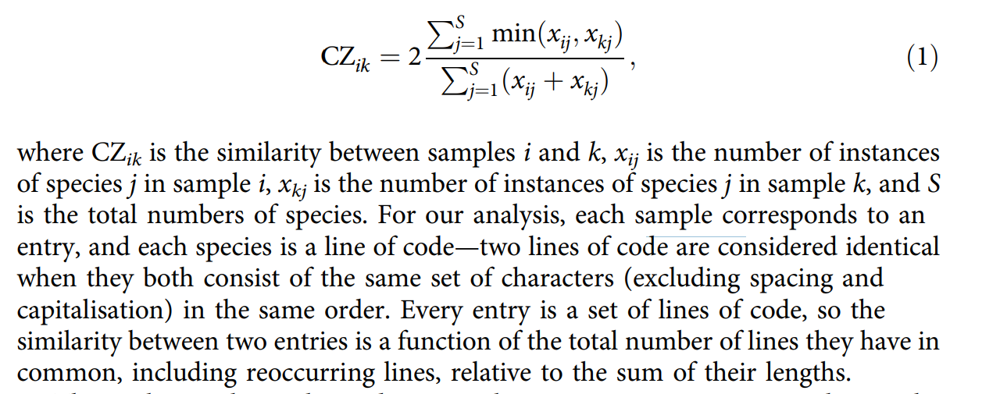

I wasn't convince that this measure was really great because it relies on the number of exact match of raw lines of codes between two codes. It is not excatly raw as they remove maj and spaces but it very unlikely that two lines of codes are exactly similar.
I think it is ok for what they are doing because they want to check if people copy-paste others people solution but it isn't obvious for more diverse code as in our ACES project. So let's find out!

First off I want to try multiple others similarity metrics to compare them to the one used in the paper (sim_paper).
## New similarity metrics 
### similarity metrics based on the Czekanowski similarity

I decompose this similarity metrics in two part.
The first part is the "tokenization". It's basically how to decompose a program in a list of $\text{tokens}=[\text{tok}_0, \text{tok}_1, ...]$ (or species if we take the terminology used for comparing two ecological samples). This is critical as this will serve as the basis to compute the similarity without good tokenization the measure will unusable. 

Then we need to compute $min(x_{0j},x_{1j})$, $x_{ij}$ correspond to how many $\text{tok}_j$ are in the sample $i$ (here $i$ is just 0 or 1 corresponding to the first or second code)
then we computer the similarity:

- $\text{sim}=2\times \frac{\sum_{j=1}^{S}{min(x_{0j},x_{1j})}}{\sum_{j=1}^{S}{x_{0j}+x_{1j}}}$
Where S is the set of all tokens exctracted from both codes.

Here is the list of tokenization method 
#### **sim_naive**

My first tokenization method is to split program based on space and newline. 
example: "tokens = code.split()" -> ['tokens', '=', 'code.split()']

#### **sim_paper**

Similarity from the paper https://www.nature.com/articles/s41467-018-04494-0 (see above)

#### **som_base_naive_plus**

find non-overlapping matching subsequences. (one subsequence of size n `a[i:i+n] == b[j:j+n]`).
The similarity is equal to the sum the size of all subsqueqence found divided by the length of the longest code.

#### **sim_base_IO**
It is based on tokenize Python module
example: "tokens = code.split()" -> ['tokens', '=', 'code', '.', 'split', '(', ')', '']

code:
```python
import tokenize
from io import BytesIO
def tokenize_code(code):
    tokens = []
    for toknum, tokval, _, _, _ in tokenize.tokenize(BytesIO(code.encode('utf-8')).readline):
        if toknum not in (tokenize.ENCODING, tokenize.ENDMARKER):
            tokens.append(tokval)
    return tokens
```

#### **sim_tiktok**

Used GPT tokenizer (from tiktoken) based on Byte Pair Encoding (c.f https://www.youtube.com/watch?v=zduSFxRajkE)
example: "tokens = code.split()" -> [31666, 284, 2082, 5402, 368]

#### **sim_base_ast**

Based on trees of the Python abstract syntax grammar (abstract syntax tree, AST package). What is cool about that is the name invariance (it also have some bad side).
It just exploring the AST of a code while collectiong its class name

example: "tokens = code.split()" -> ['Module', 'Assign', 'Name', 'Store', 'Call', 'Attribute', 'Name', 'Load', 'Load']
```python
import ast
def tokenizer_ast(code):
    node_code = ast.parse(code)
    def get_all_nodes(node, nodes=None):
        if nodes is None:
            nodes = []
        nodes.append(node.__class__.__name__)
        for child in ast.iter_child_nodes(nodes):
            get_all_nodes(child, nodes)
        return nodes
    return get_all_nodes(node_code)
```

#### **sim_base_ast_matching**
A variation of **sim_base_ast**, same tokenization but the similiarity score is just the sum of the sizes (lengths) of all matching blocks divided by the maximum length of the two node lists


### LLM based similarity 

Take the embedding of code and compute the cosine similarity. To compute the embedding I applied mean pool along the sequence length over the features.

## checking the similarity matrix on archive (aces, rd-gen, elm-nlp)

[similarity here]
You need to know that x-axis (and y-axis) correspond to the id of puzzle the first first ~ 140 puzzles are from the P3 trainset then others puzzle are sort by when they were created. So x-axis can be similar to time (same for y-axis as it is a symetric matrix).

What's striking to me is that we can clearly see when the P3 trainset end, see darker area that are mostly present when a puzzle of the trainset is involved. 

This phenomena is more visible with some metric than other it probably means that they are more meaningful as diversity metrics (for our case).
To compare them I tried to separate the trainset puzzles and the synthetic puzzles generated by one of our method.




### Try to separate trainset with synthetic puzzles 
To keep relatively simple, I took the average of the top_k similarity of each puzzles and plot them on histograms.

[plot histo]

To have a simple metrics I computed the overlap as the intersection between P3 trainset and archive's puzzles.
(probably best to find the decision boundary that maximize the f1-score  and use the best f1-score achievable instead of overlap but didn't want to spend to much time on that)


To compare those metrics I plotted the overlap along k (of top_k). I used top_k as I think that averaging similarity over to many puzzle is more noisy in our case but we need to have at least a few dozen of puzzles to compute a kind of diversity to not have a metrics that just check if there is a duplicate or not.
[3 plots to compare sim dezoom]
If we take a broad look at the figure, for $k>50$ similarity with the lowest overlap (lower is better) are from best to last:
- sim_tiktok (based on GPT tokeniser)
- sim_naive (~n-grams overlap)
- sim_base_IO
- sim_ast

note: There is some weird stuff with sim_base_naive_plus when k>300 that would need further investigation

You can also check the transition phase here (figure zoom on top-k (with k<5)):
[3 plots to compare sim zoom]
Nothing much to say apart that sim_base_tiktok is best when k<3 followed by sim_paper.

Lastly I compare for k=50 the 3 archive on all similarity:
[overlap accros dataset here]

We can interpret those result in terms of diversity; higher overlap means it's more difficult to separate the set of P3 trainset from the set of synthetic puzzle. So higher overlap should correlate with higher diversity.

On the plot above ACES has the highest overlap on all metrics followed elm_nlp and rdgen.
Those metrics also correlate with the number of niche filled (c.f first fig of post above: https://openlab-flowers.inria.fr/t/weekly-de-julien-pourcel/2239/83?u=julien)


In [9]:
# with 'tokenize' module from Python to tokenize the Python code.
# Function to tokenize Python code using the 'tokenize' module

import tokenize
from io import BytesIO
def tokenize_code(code):
    tokens = []
    for toknum, tokval, _, _, _ in tokenize.tokenize(BytesIO(code.encode('utf-8')).readline):
        if toknum not in (tokenize.ENCODING, tokenize.ENDMARKER):
            tokens.append(tokval)
    return tokens

def sim_base_IO(a, b):
    tokens1 = tokenize_code(a)
    tokens2 = tokenize_code(b)

    # Getting the set of unique tokens from both token lists
    unique_tokens = set(tokens1).union(tokens2)

    # Calculating x_ij and x_kj for each unique token
    x_ij = {token: tokens1.count(token) for token in unique_tokens}
    x_kj = {token: tokens2.count(token) for token in unique_tokens}

    # Calculating CZ_ik using the formula
    cz_numerator = sum(min(x_ij[token], x_kj[token]) for token in unique_tokens)
    cz_denominator = sum(x_ij[token] + x_kj[token] for token in unique_tokens)

    cz_ik = 2 * cz_numerator / cz_denominator if cz_denominator != 0 else 0
    return cz_ik


In [10]:
[plot histo]
ik using the formula
    cz_numerator = sum(min(x_ij[token], x_kj[token]) for token in unique_tokens)
    cz_denominator = sum(x_ij[token] + x_kj[token] for token in unique_tokens)

    cz_ik = 2 * cz_numerator / cz_denominator if cz_denominator != 0 else 0
    return cz_ik
sim_base_tiktok(code1, code2)


0.6666666666666666

# ast

In [11]:
import ast
import difflib

# Define the code snippets as strings
code1_str = """
def f(factorial: int, n=5) -> bool:
    return math.factorial(n) == factorial
"""

code2_str = """
def g(n=5) -> int:
    return math.factorial(n)
"""
def tokenizer_ast(code):
    node_code = ast.parse(code)
    def get_all_nodes(node, nodes=None):
        if nodes is None:
            nodes = []
        nodes.append(node.__class__.__name__)
        for child in ast.iter_child_nodes(node):
            get_all_nodes(child, nodes)
        return nodes
    return get_all_nodes(node_code)



def sim_base_ast(a, b):


    # Get all nodes for both ASTs
    tokens1 = tokenizer_ast(a)
    tokens2 = tokenizer_ast(b)

    unique_tokens = set(tokens1).union(tokens2)
    x_ij = {token: tokens1.count(token) for token in unique_tokens}
    x_kj = {token: tokens2.count(token) for token in unique_tokens}

    # Calculating CZ_ik using the formula
    cz_numerator = sum(min(x_ij[token], x_kj[token]) for token in unique_tokens)
    cz_denominator = sum(x_ij[token] + x_kj[token] for token in unique_tokens)

    cz_ik = 2 * cz_numerator / cz_denominator if cz_denominator != 0 else 0
    return cz_ik#, blocks


In [12]:
from transformers import AutoModel, AutoTokenizer
import torch
checkpoint = "Salesforce/codet5p-110m-embedding"
device = "cuda"  # for GPU usage or "cpu" for CPU usage

tokenizer1 = AutoTokenizer.from_pretrained(checkpoint, trust_remote_code=True)
model1 = AutoModel.from_pretrained(checkpoint, trust_remote_code=True).to(device)
def embed_code(code):
    with torch.inference_mode():
        inputs = tokenizer1.encode(code, return_tensors="pt").to(device)
        embedding = model1(inputs)[0]
    return embedding

def sim_matrix_llm(list_code):
    with torch.inference_mode():
        list_emb=[]
        for i in list_code:
            list_emb.append(embed_code(i))
        embeddings = torch.stack(list_emb)
        embeddings_norm = torch.nn.functional.normalize(embeddings, p=2, dim=1)
        
        # Compute the similarity matrix: (batch_size x dim) x (dim x batch_size) -> (batch_size x batch_size)
        similarity_matrix = torch.matmul(embeddings_norm, embeddings_norm.transpose(0, 1)).cpu()
    
    return similarity_matrix

def sim_pairwise_llm(f,g):
    with torch.inference_mode():
        list_emb=[]
        for i in [f,g]:
            list_emb.append(embed_code(i))
        embeddings = torch.stack(list_emb)
        embeddings_norm = torch.nn.functional.normalize(embeddings, p=2, dim=1)
        
        # Compute the similarity matrix: (batch_size x dim) x (dim x batch_size) -> (batch_size x batch_size)
        similarity_matrix = torch.matmul(embeddings_norm, embeddings_norm.transpose(0, 1)).cpu()
    
    return similarity_matrix[0,1].item()


/home/flowers/miniconda3/envs/codegpt/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


In [13]:
from HF_key import hf_token
from transformers import AutoModel, AutoTokenizer
from huggingface_hub import login

login(hf_token)


model2 = AutoModel.from_pretrained('jinaai/jina-embeddings-v2-base-code', trust_remote_code=True)
# embeddings = model2.encode(
#     [
#         'How do I access the index while iterating over a sequence with a for loop?',
#         '# Use the built-in enumerator\nfor idx, x in enumerate(xs):\n    print(idx, x)',
#     ]*1000
# )

def sim_matrix_llm2(list_code):
    with torch.inference_mode():
        embeddings=torch.tensor(model2.encode(list_code))
        embeddings_norm = torch.nn.functional.normalize(embeddings, p=2, dim=1)
        
        # Compute the similarity matrix: (batch_size x dim) x (dim x batch_size) -> (batch_size x batch_size)
        similarity_matrix = torch.matmul(embeddings_norm, embeddings_norm.transpose(0, 1)).cpu()
    
    return similarity_matrix

def sim_pairwise_llm2(f,g):
    with torch.inference_mode():
        embeddings=torch.tensor(model2.encode([f,g]))
        embeddings_norm = torch.nn.functional.normalize(embeddings, p=2, dim=1)
        
        # Compute the similarity matrix: (batch_size x dim) x (dim x batch_size) -> (batch_size x batch_size)
        similarity_matrix = torch.matmul(embeddings_norm, embeddings_norm.transpose(0, 1)).cpu()
    
    return similarity_matrix[0,1].item()


Token will not been saved to git credential helper. Pass `add_to_git_credential=True` if you want to set the git credential as well.
Token is valid (permission: read).
Your token has been saved to /home/flowers/.cache/huggingface/token
Login successful


In [72]:
# from transformers import AutoModelForCausalLM,AutoTokenizer
# import torch
# device="cuda"
# model_id="/home/flowers/work/hf/deepseek-coder-1.3b-instruct"
# tokenizer_deepseek = AutoTokenizer.from_pretrained(model_id, trust_remote_code=True)
# model_deepseek = AutoModelForCausalLM.from_pretrained(model_id, trust_remote_code=True).to(device)

# prompt_education="""###
# This is a educational datapoint to give to students during their exams:
# ```python
# {datapoint}
# ###
# Does the previous paragraph demarcated within ### and ###
# contain informative signal to a large-language model?
# An informative datapoint should be well-formatted, contain some
# usable knowledge of the world.
# OPTIONS:
# - Yes
# - No
# """
# def prompt_model_id(model_id):
#     if "deepseek-coder-1.3b-instruct" in model_id:
#         prompt_deepseek_model= """You are an AI programming assistant, utilizing the DeepSeek Coder model, developed by DeepSeek Company, and you only answer questions related to computer science.
# ### Instruction:
# {instruction}
# ### Response:
# """

In [14]:
from transformers import pipeline,AutoTokenizer
model_id="/home/flowers/work/hf/deepseek-coder-1.3b-instruct"

tokenizer_deepseek = AutoTokenizer.from_pretrained(model_id, trust_remote_code=True)
feature_extractor_deepseek = pipeline("feature-extraction",framework="pt",model=model_id,device_map="auto")
prompt_deepseek_model= """You are an AI programming assistant.
### Instruction:
Analyze this code:
{instruction}"""
len_prompt_deepseek = len(tokenizer_deepseek.encode(prompt_deepseek_model.split("{instruction}")[0]))

out=feature_extractor_deepseek(prompt_deepseek_model.format(instruction="aaaaaaaaaaaaaaaaaaaaaa"),return_tensors = "pt")[0,len_prompt_deepseek:].mean(axis=0)
def sim_matrix_deepseek(list_code):
    with torch.inference_mode():
        embeddings=[]
        for code in list_code:
            full_prompt = prompt_deepseek_model.format(instruction=code)
            out= feature_extractor_deepseek(full_prompt,return_tensors = "pt")[0,len_prompt_deepseek:].mean(axis=0)
            embeddings.append(out)
        embeddings=torch.stack(embeddings)
        embeddings_norm = torch.nn.functional.normalize(embeddings, p=2, dim=1)
        
        # Compute the similarity matrix: (batch_size x dim) x (dim x batch_size) -> (batch_size x batch_size)
        similarity_matrix = torch.matmul(embeddings_norm, embeddings_norm.transpose(0, 1)).cpu()
    return similarity_matrix

def sim_pairwise_deepseek(f,g):
    with torch.inference_mode():
        embeddings=[]
        for code in [f,g]:
            full_prompt = prompt_deepseek_model.format(instruction=code)
            out= feature_extractor_deepseek(full_prompt,return_tensors = "pt")[0,len_prompt_deepseek:].mean(axis=0)
            embeddings.append(out)
        embeddings=torch.stack(embeddings)
        embeddings_norm = torch.nn.functional.normalize(embeddings, p=2, dim=1)
        
        # Compute the similarity matrix: (batch_size x dim) x (dim x batch_size) -> (batch_size x batch_size)
        similarity_matrix = torch.matmul(embeddings_norm, embeddings_norm.transpose(0, 1)).cpu()
    
    return similarity_matrix[0,1].item()


Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [15]:
import torch
from transformers import AutoModelForCausalLM, GPTQConfig
model_id="/home/flowers/work/hf/deepseek-coder-6.7B-base-GPTQ"
gptq_config = GPTQConfig(bits=4, exllama_config={"version":2})

tokenizer_deepseek7b = AutoTokenizer.from_pretrained(model_id, trust_remote_code=True)
len_prompt_deepseek = len(tokenizer_deepseek7b.encode(prompt_deepseek_model.split("{instruction}")[0]))

deepseek7b = AutoModelForCausalLM.from_pretrained(model_id, device_map="auto", quantization_config=gptq_config)
feature_extractor_deepseek7b = pipeline("feature-extraction",framework="pt",model=deepseek7b,tokenizer=tokenizer_deepseek7b)

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
You passed `quantization_config` to `from_pretrained` but the model you're loading already has a `quantization_config` attribute and has already quantized weights. However, loading attributes (e.g. ['use_cuda_fp16', 'use_exllama', 'max_input_length', 'exllama_config', 'disable_exllama']) will be overwritten with the one you passed to `from_pretrained`. The rest will be ignored.


In [16]:
def sim_matrix_deepseek7b(list_code):
    with torch.inference_mode():
        embeddings=[]
        # list_prompt=[prompt_deepseek_model.format(instruction=code) for code in list_code]
        embeddings = feature_extractor_deepseek7b(list_code,return_tensors = "pt")
        for id_emb in range(len(embeddings)):
            embeddings[id_emb]=embeddings[id_emb][0,].mean(axis=0)
        embeddings=torch.stack(embeddings)
        embeddings_norm = torch.nn.functional.normalize(embeddings, p=2, dim=1)
        
        # Compute the similarity matrix: (batch_size x dim) x (dim x batch_size) -> (batch_size x batch_size)
        similarity_matrix = torch.matmul(embeddings_norm, embeddings_norm.transpose(0, 1)).cpu()
    return similarity_matrix


In [17]:
import numpy as np
from tqdm import trange

def compute_similarity_matrix(list_data,sim):
    n = len(list_data)
    similarity_matrix = np.zeros((n, n))  # Initialize a square matrix
    
    for i in trange(n):
        for j in range(i, n):  # Start from i to avoid recomputing similarities
            if i == j:
                similarity_matrix[i, j] = 1  # The similarity of a program with itself is 1
            else:
                score = sim(list_data[i], list_data[j])
                similarity_matrix[i, j] = score
                similarity_matrix[j, i] = score  # Fill both (i, j) and (j, i) to make the matrix symmetric
                
    return similarity_matrix


In [18]:
import matplotlib.pyplot as plt

# Assuming list_data is defined somewhere and the sim_* functions are defined
# Also assuming sim_matrix_llm and sim_matrix_llm2 are defined functions to compute similarity matrices
list_sim_function=[sim_naive,sim_base_naive_plus,sim_paper,sim_base_IO,sim_base_tiktok,sim_base_ast]
list_name_sim = [i.__name__ for i in list_sim_function] + ["Salesforce/codet5p-110m-embedding", 'jinaai/jina-embeddings-v2-base-code',"deepseek-coder-1.3b-instruct","deepseek-coder-6.7B-base-GPTQ"]

def compute_all_sim(list_data,name_data="ACES",list_sim_function=list_sim_function,list_name_sim=list_name_sim):
    list_sim = []

    # Compute similarity matrices and add them to list_sim
    for sim in list_sim_function:
        similarity_matrix = compute_similarity_matrix(list_data, sim=sim)
        list_sim.append(similarity_matrix)

    # Add similarity matrices from LLM methods
    list_sim.append(sim_matrix_llm(list_data))
    list_sim.append(sim_matrix_llm2(list_data))
    list_sim.append(sim_matrix_deepseek(list_data))
    list_sim.append(sim_matrix_deepseek7b(list_data))


    # Create a figure and subplots
    fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(12, 24), dpi=200)
    axes = axes.flatten()  # Flatten the array of axes for easy indexing

    for i, ax in enumerate(axes):
        if i < len(list_sim):
            im = ax.imshow(list_sim[i], cmap="viridis")
            ax.set_title(list_name_sim[i]+"\n("+name_data+")")
            fig.colorbar(im, ax=ax)

    plt.tight_layout()
    plt.savefig("/home/flowers/work/OpenELM/analysis_P3/diversity/save_plot/matrix_similarity_"+name_data+".png")
    plt.show()
    return list_sim

In [19]:
def extract_topk(sim_matr,k=1):
    sim_matr = torch.tensor(sim_matr).clone()
    sim_matr=sim_matr.fill_diagonal_(float('-inf'))
    topk = torch.topk(sim_matr, k, dim=1)
    # print(topk.values.shape)
    return topk.values.mean(dim=1)

def histogram_intersection(hist1, hist2):
    return np.sum(np.minimum(hist1, hist2))
def normalize_histograms(hist1, hist2, bins):
    # Define bin edges for both histograms
    bin_edges1 = np.linspace(np.min(hist1), np.max(hist1), bins + 1)
    bin_edges2 = np.linspace(np.min(hist2), np.max(hist2), bins + 1)

    # Compute histograms using the same bin edges
    hist1_norm, _ = np.histogram(hist1, bins=bin_edges1)
    hist2_norm, _ = np.histogram(hist2, bins=bin_edges2)

    return hist1_norm, hist2_norm,bin_edges1,bin_edges2

In [35]:
import matplotlib.pyplot as plt
import numpy as np

def just_compute_histo_overlap(value1, value2, nbins=50):
    bins = np.linspace(min(min(value1), min(value2)), max(max(value2), max(value1)), nbins)
    hist1, _ = np.histogram(value1, bins=bins, density=False)
    hist2, _ = np.histogram(value2, bins=bins, density=False)
    overlap_hist = np.minimum(hist1, hist2)
    overlap_area_estimate = np.sum(overlap_hist) #* (bins[1] - bins[0])
    return overlap_area_estimate

# Adjusted function to accept an axis for plotting
def compute_histo_overlap(value1, value2, ax, title="", nbins=50):
    bins = np.linspace(min(min(value1), min(value2)), max(max(value2), max(value1)), nbins)
    hist1, _ = np.histogram(value1, bins=bins, density=False)
    hist2, _ = np.histogram(value2, bins=bins, density=False)
    overlap_hist = np.minimum(hist1, hist2)
    overlap_area_estimate = np.sum(overlap_hist) #* (bins[1] - bins[0])

    # hist1, _ = np.histogram(value1, bins=bins, density=False)
    # hist2, _ = np.histogram(value2, bins=bins, density=False)
    overlap_hist = np.minimum(hist1, hist2)
    # Use the provided axis for plotting
    ax.hist(value1, bins=bins, alpha=0.5, label='trainset', density=False)
    ax.hist(value2, bins=bins, alpha=0.5, label='archive', density=False)
    ax.plot(bins[:-1], hist1, label='Histogram 1', drawstyle='steps-post')
    ax.plot(bins[:-1], hist2, label='Histogram 2', drawstyle='steps-post')
    ax.fill_between(bins[:-1], overlap_hist, step="post", alpha=0.8, label='Overlap Area', color='b')
    ax.legend()
    ax.set_title('Histograms of similarity based on '+title + "\noverlap area ={:.2f}".format(overlap_area_estimate))
    ax.set_xlabel('Similarity')
    ax.set_ylabel('Number of puzzles')
    return overlap_area_estimate


def plot_all_histo(list_sim,idx_train,idx_archive,name_data="",k = 5, n_bins=60):
    overlap_values = []

    # Example usage with your data
    # Assuming list_sim, idx_train, idx_archive, and list_name are defined elsewhere

    fig, axs = plt.subplots(5, 2, figsize=(20, 24)) # Adjust the figure size as needed
    axs = axs.flatten() # Flatten the array to easily iterate over it

    for idx, i in enumerate(list_sim):
        values_train = extract_topk(i[idx_train], k).flatten()
        values_archive = extract_topk(i[idx_archive], k).flatten()
        overlap = compute_histo_overlap(values_train, values_archive, axs[idx], title=list_name_sim[idx], nbins=n_bins)
        overlap_values.append((list_name_sim[idx], overlap))

    sorted_overlaps = sorted(overlap_values, key=lambda x: x[1])


    plt.tight_layout()
    plt.savefig("/home/flowers/work/OpenELM/analysis_P3/diversity/save_plot/histo_similarity_"+name_data+".pdf")

    plt.show()
    return sorted_overlaps

def barplot_overlap(sorted_overlaps,name_data=""):
    names, overlaps = zip(*sorted_overlaps) # This unpacks the sorted list into names and their overlaps
    plt.figure(figsize=(10, 6))
    plt.bar(names, overlaps)
    plt.xlabel('Names similarity')
    plt.ylabel('Overlap Values')
    plt.title('Overlap Values Sorted by Names\n('+name_data+")")
    plt.xticks(ticks=range(len(names)),rotation=45,ha='right') # Rotate names for better visibility
    plt.tight_layout() # Adjust layout to make room for the rotated x-axis labels
    plt.savefig("/home/flowers/work/OpenELM/analysis_P3/diversity/save_plot/histo_similarity_1fig_"+name_data+".pdf")
    plt.show()

def plot_overlap_topk(list_sim,idx_train,idx_archive,list_name_sim,name_data,max_k=100,n_bins=100,save=True):
    k_list=[i for i in range(1,max_k)]
    list_overlap=[[] for i in range(len(list_sim))]
    for k in k_list:
        for idx,i in enumerate(list_sim):
            values_train = extract_topk(i[idx_train],k).flatten()
            values_archive = extract_topk(i[idx_archive],k).flatten()
            overlap=just_compute_histo_overlap(values_train,values_archive,nbins=n_bins)
            list_overlap[idx].append(overlap)

    plt.figure(dpi=200)
    for idx,i in enumerate(list_overlap):
        plt.plot(k_list,i)
    plt.legend(list_name_sim,fontsize="5")
    plt.xlabel("k (top-k)")
    plt.ylabel("overlap area ")
    plt.title("overlap area between sim_topk(train,archive) \nand sim_topk(archive,archive) for different k\n("+name_data+")")
    plt.tight_layout() 
    if save:
        plt.savefig("/home/flowers/work/OpenELM/analysis_P3/diversity/save_plot/overlap_topk_"+name_data+".pdf")
    plt.show()

# compute similarity

  0%|          | 0/961 [00:00<?, ?it/s]

100%|██████████| 961/961 [01:42<00:00,  9.42it/s] 
Token indices sequence length is longer than the specified maximum sequence length for this model (516 > 512). Running this sequence through the model will result in indexing errors
/home/flowers/miniconda3/envs/codegpt/lib/python3.10/site-packages/transformers/pipelines/base.py:1123: UserWarning: You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
  warnings.warn(


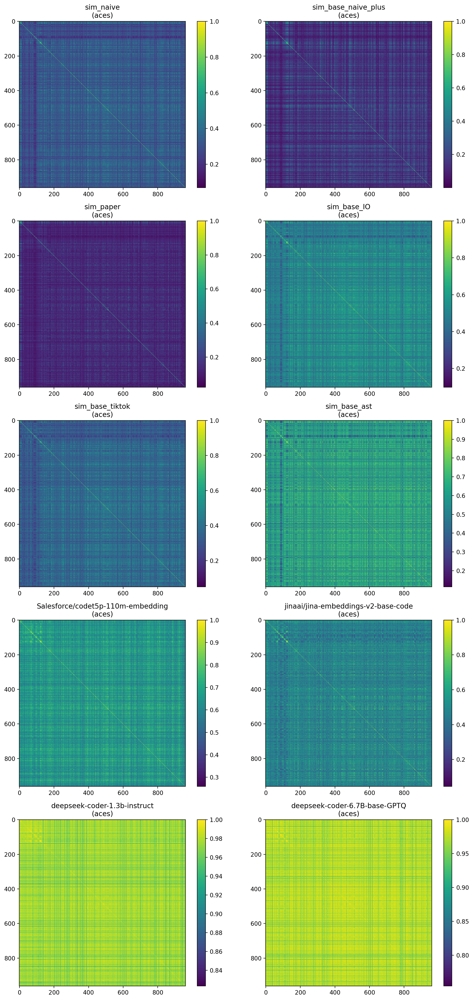

/tmp/ipykernel_9389/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


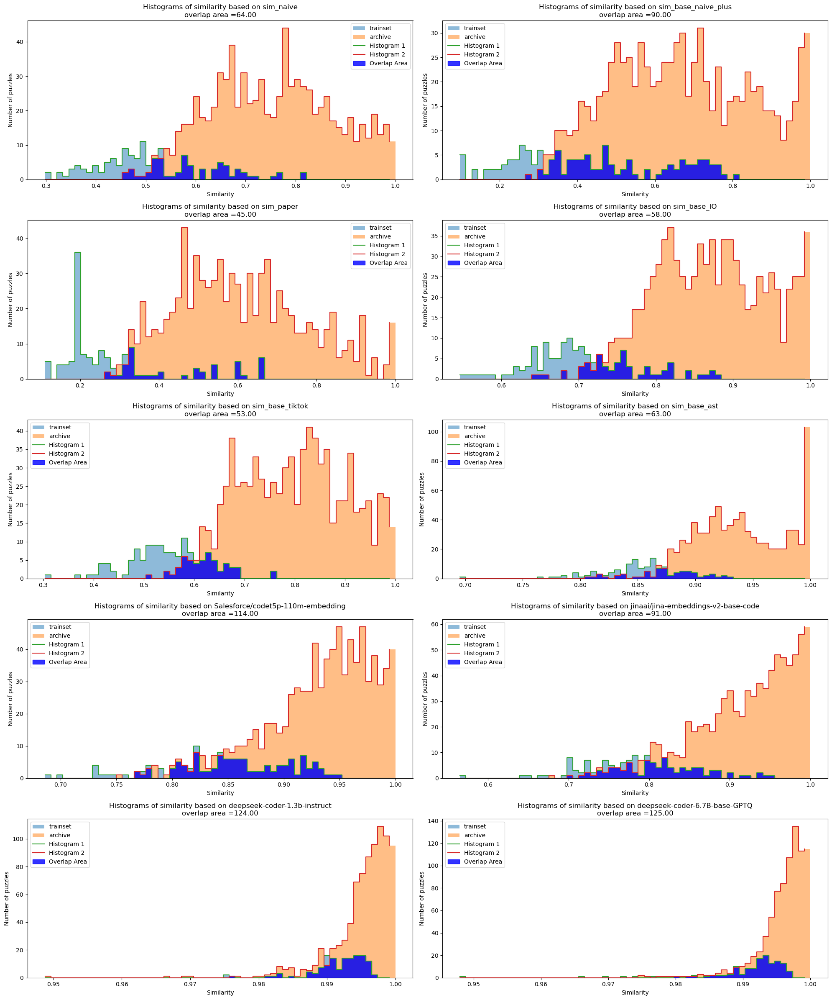

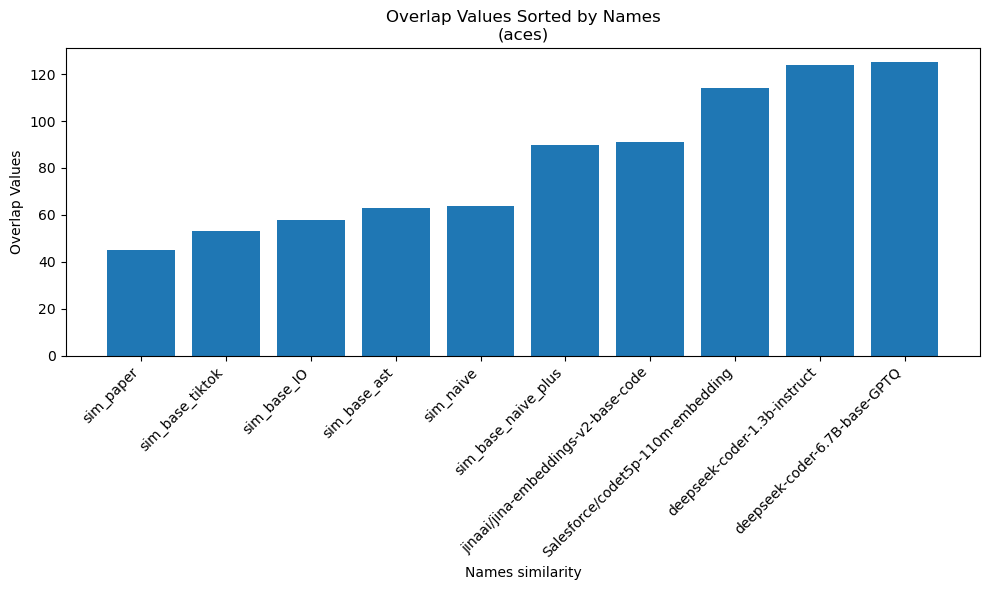

/tmp/ipykernel_9389/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


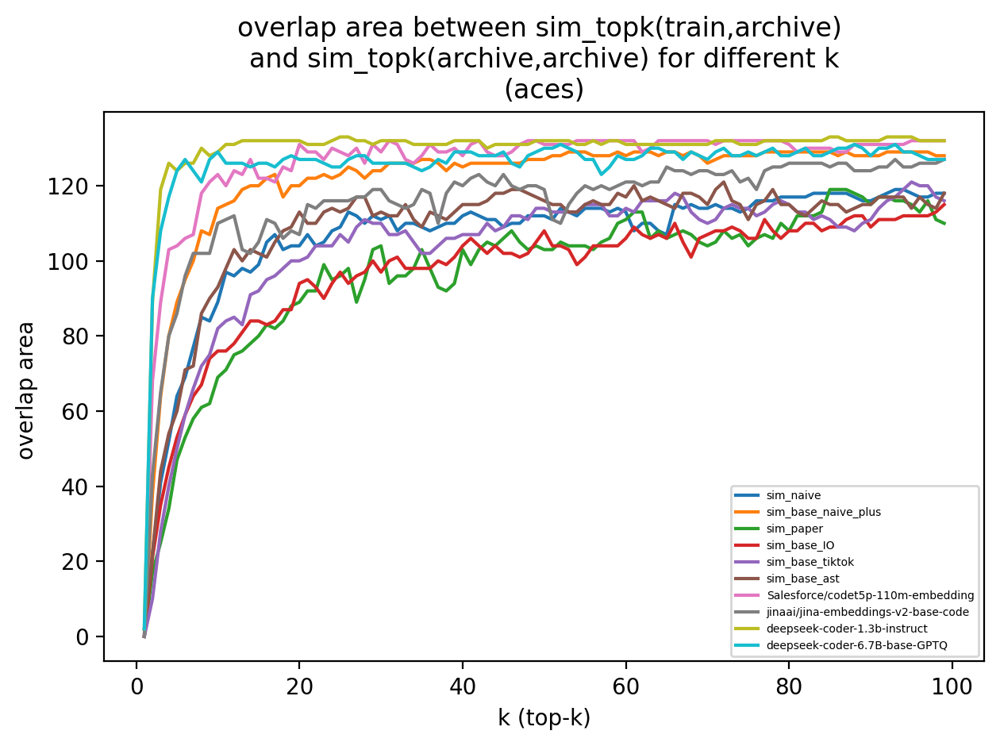

100%|██████████| 1337/1337 [02:44<00:00,  8.14it/s] 
/home/flowers/miniconda3/envs/codegpt/lib/python3.10/site-packages/transformers/pipelines/base.py:1123: UserWarning: You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
  warnings.warn(


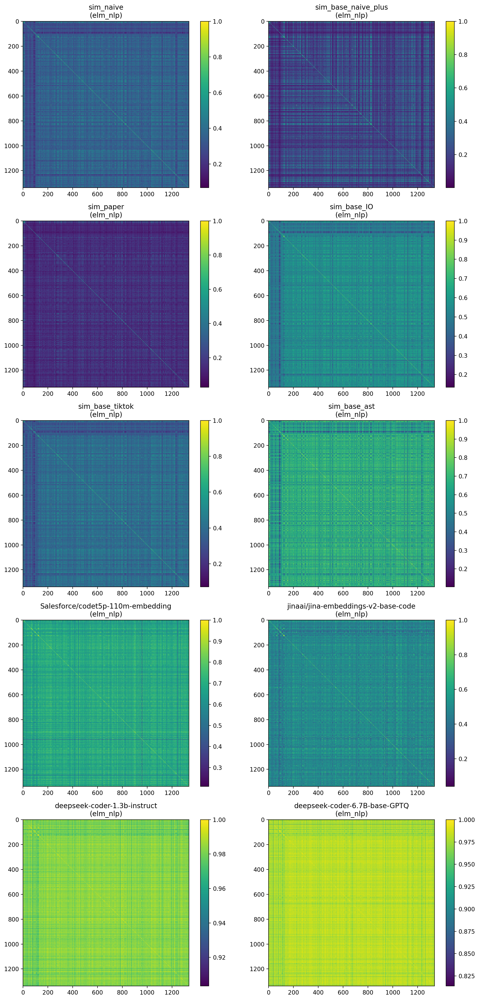

/tmp/ipykernel_9389/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


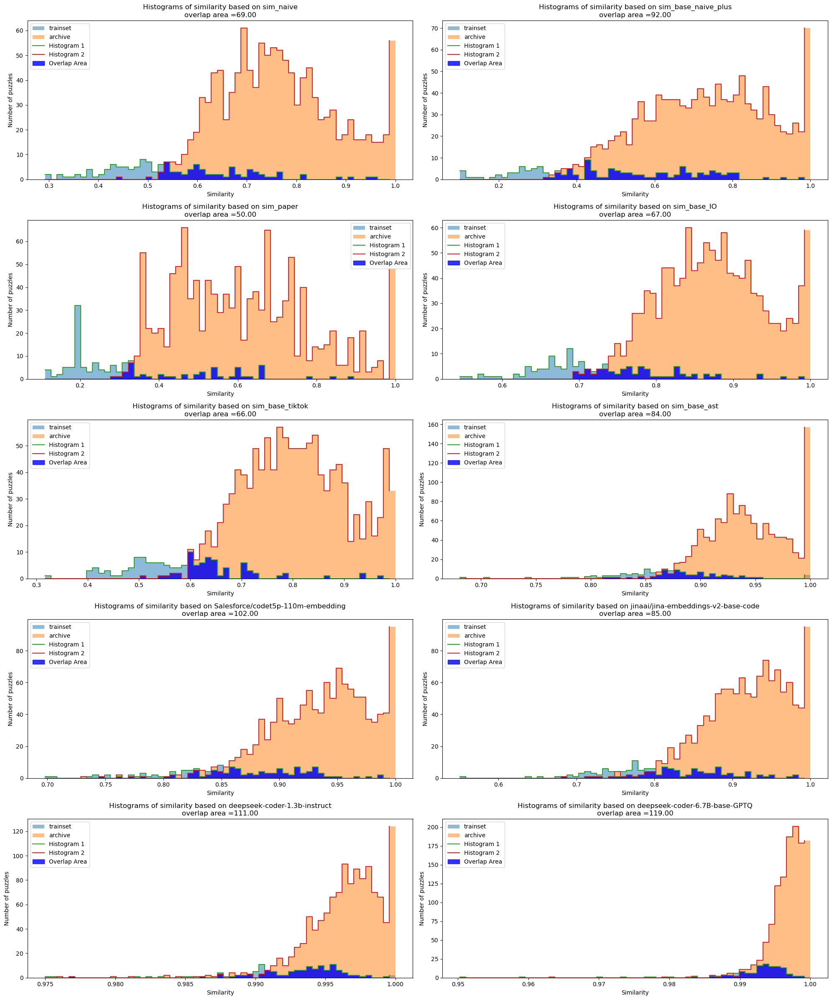

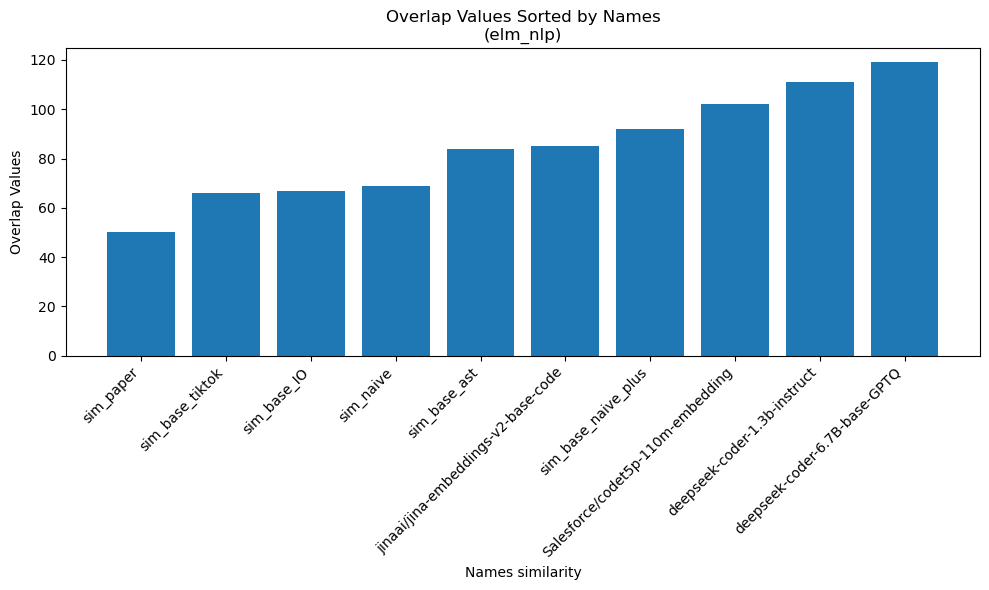

/tmp/ipykernel_9389/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


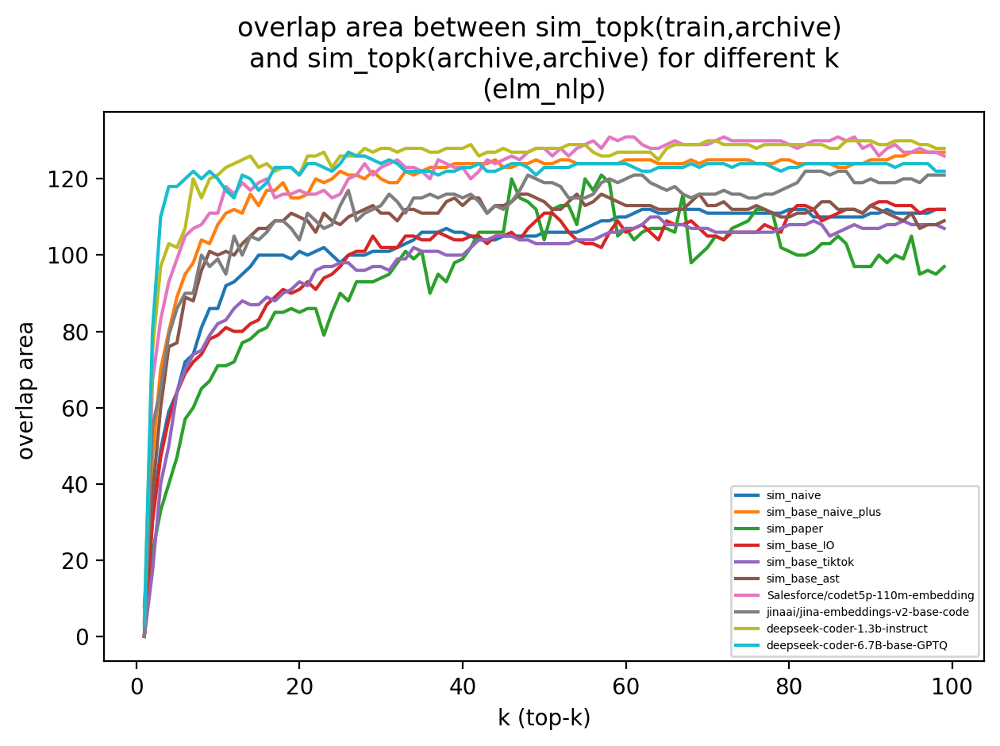

 33%|███▎      | 419/1264 [03:15<06:33,  2.15it/s]


KeyboardInterrupt: 

In [99]:
import json
import copy
path_imgp = "/home/flowers/work/OpenELM/analysis_P3/quality/to_analyse/maps_1_imgep_smart.json"
path_elm = "/home/flowers/work/OpenELM/analysis_P3/quality/to_analyse/maps_1_elm_NLP.json"
path_rd_gen = "/home/flowers/work/OpenELM/analysis_P3/quality/to_analyse/maps_1_rd_gen.json"
list_path=[path_imgp,path_elm,path_rd_gen]
list_name_path = ["aces","elm_nlp",'rdgen']
dic={}
for idx,path in enumerate(list_path):
    with open(path, "r") as file:
        data = json.load(file)

    list_data= [d["program_str"] for d in data]

    list_data_idx= [d["idx_generation"] for d in data]
    # compute all sim
    list_sim = compute_all_sim(list_data,name_data=list_name_path[idx])
    
    dic[list_name_path[idx]] = {"list_sim":copy.deepcopy(list_sim),"data":data}

    list_data_idx=torch.tensor(list_data_idx)
    idx_train = list_data_idx==-1
    idx_archive = list_data_idx!=-1
    # plot all histo
    sorted_overlaps = plot_all_histo(list_sim,idx_train,idx_archive,name_data=list_name_path[idx])
    barplot_overlap(sorted_overlaps,name_data=list_name_path[idx])
    plot_overlap_topk(list_sim,idx_train,idx_archive,list_name_sim,name_data=list_name_path[idx])

# with open("/home/flowers/work/OpenELM/analysis_P3/diversity/dic_sim.json", "w") as file:
#     json.dump(dic, file, indent=4)

In [4]:
# with open("/home/flowers/work/OpenELM/analysis_P3/diversity/dic_sim.json", "w") as file:
#     json.dump(dic, file, indent=4)
import pickle 
import torch
# with open("/home/flowers/work/OpenELM/analysis_P3/diversity/dic_sim.pkl", "wb") as file:
#     pickle.dump(dic, file)
with open("/home/flowers/work/OpenELM/analysis_P3/diversity/dic_sim.pkl", "rb") as file:
    dic = pickle.load(file)

In [21]:

path_imgp = "/home/flowers/work/OpenELM/analysis_P3/quality/to_analyse/maps_1_imgep_smart.json"
path_elm = "/home/flowers/work/OpenELM/analysis_P3/quality/to_analyse/maps_1_elm_NLP.json"
path_rd_gen = "/home/flowers/work/OpenELM/analysis_P3/quality/to_analyse/maps_1_rd_gen.json"
list_path=[path_imgp,path_elm,path_rd_gen]
list_name_path = ["aces","elm_nlp",'rdgen']
idx = 0
# for idx in range(len(list_name_path)):
#     data = dic[list_name_path[idx]]["data"]
#     list_sim= dic[list_name_path[idx]]["list_sim"]
#     list_data= [d["program_str"] for d in data]
#     list_data_idx= [d["idx_generation"] for d in data] 
#     list_data_idx=torch.tensor(list_data_idx)
#     idx_train = list_data_idx==-1
#     idx_archive = list_data_idx!=-1
#     sorted_overlaps = plot_all_histo(list_sim,idx_train,idx_archive,name_data=list_name_path[idx])
#     barplot_overlap(sorted_overlaps,name_data=list_name_path[idx])
#     plot_overlap_topk(list_sim,idx_train,idx_archive,list_name_sim,name_data=list_name_path[idx],max_k=100)


/tmp/ipykernel_4578/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


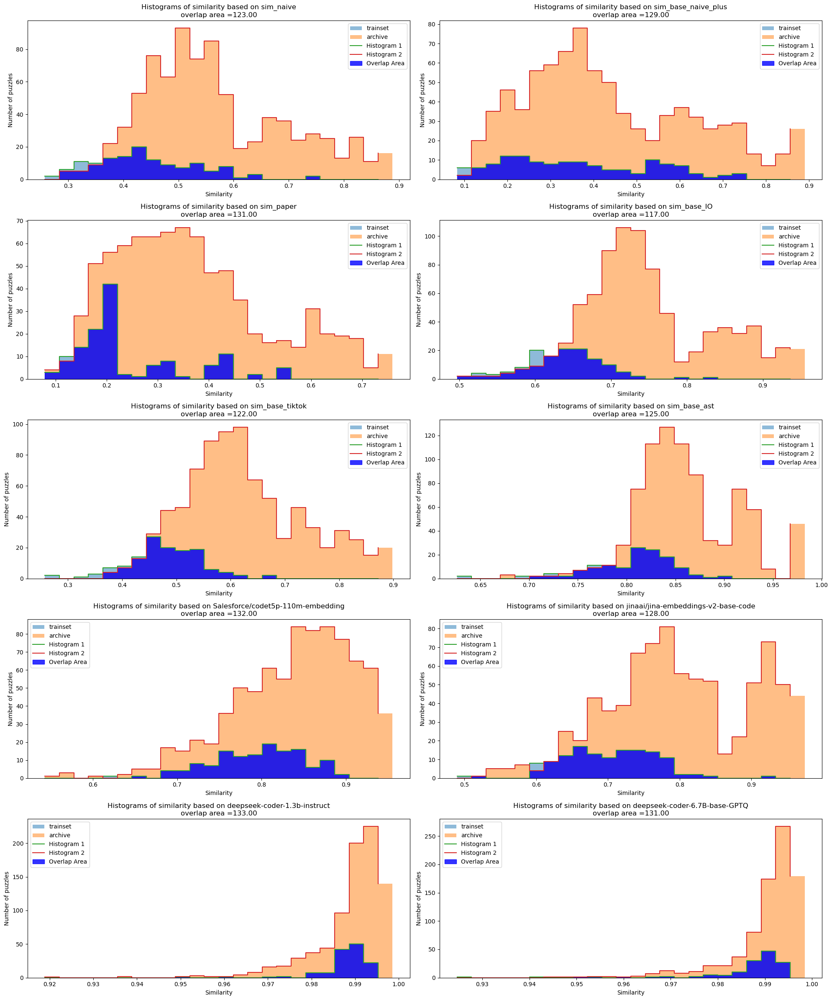

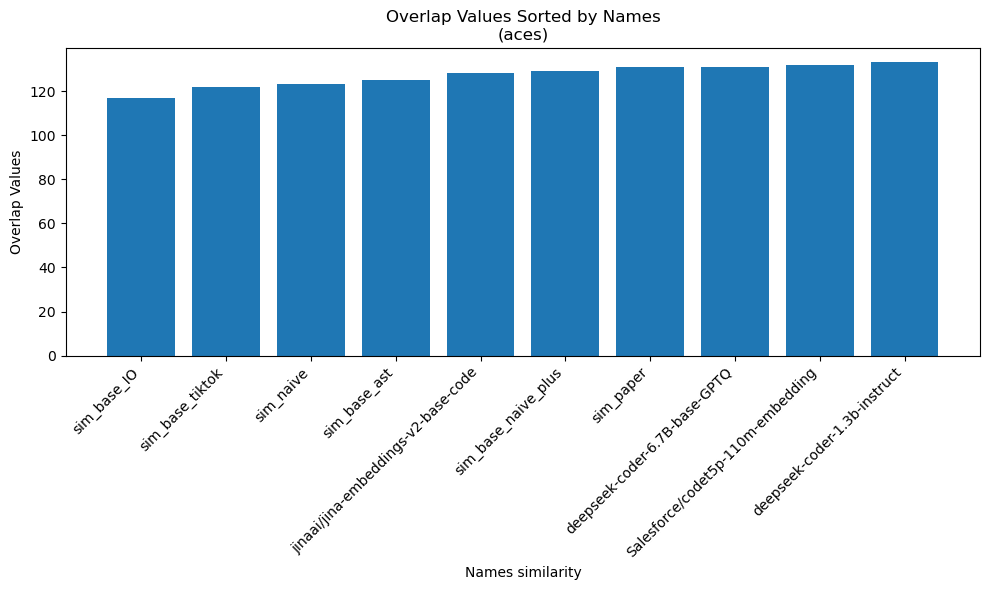

/tmp/ipykernel_4578/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


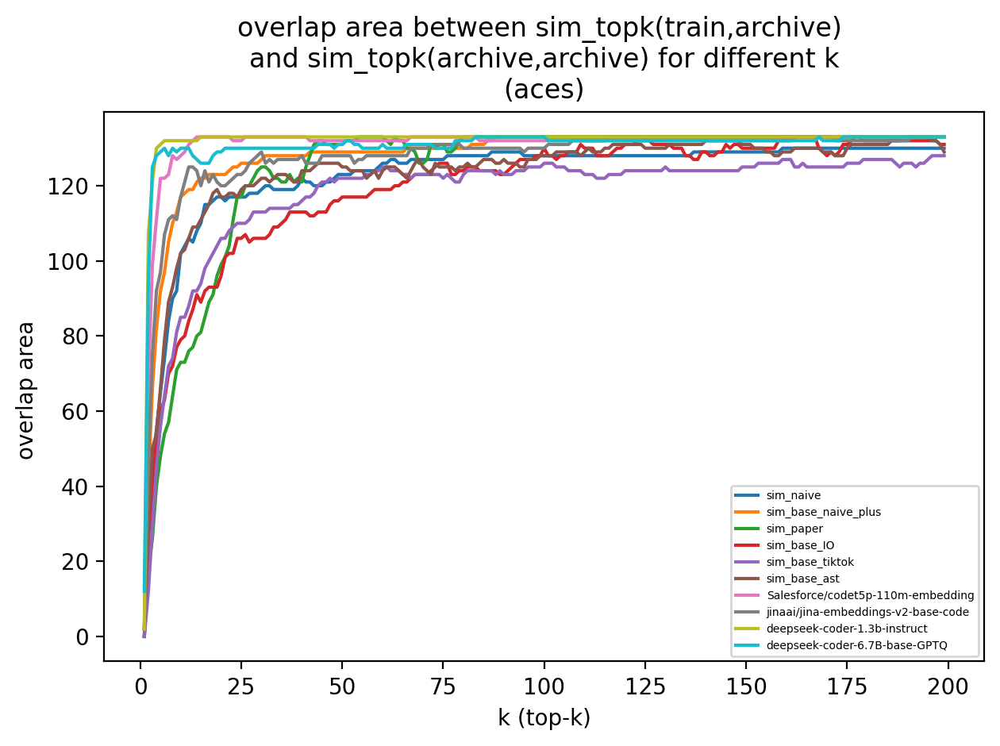

/tmp/ipykernel_4578/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


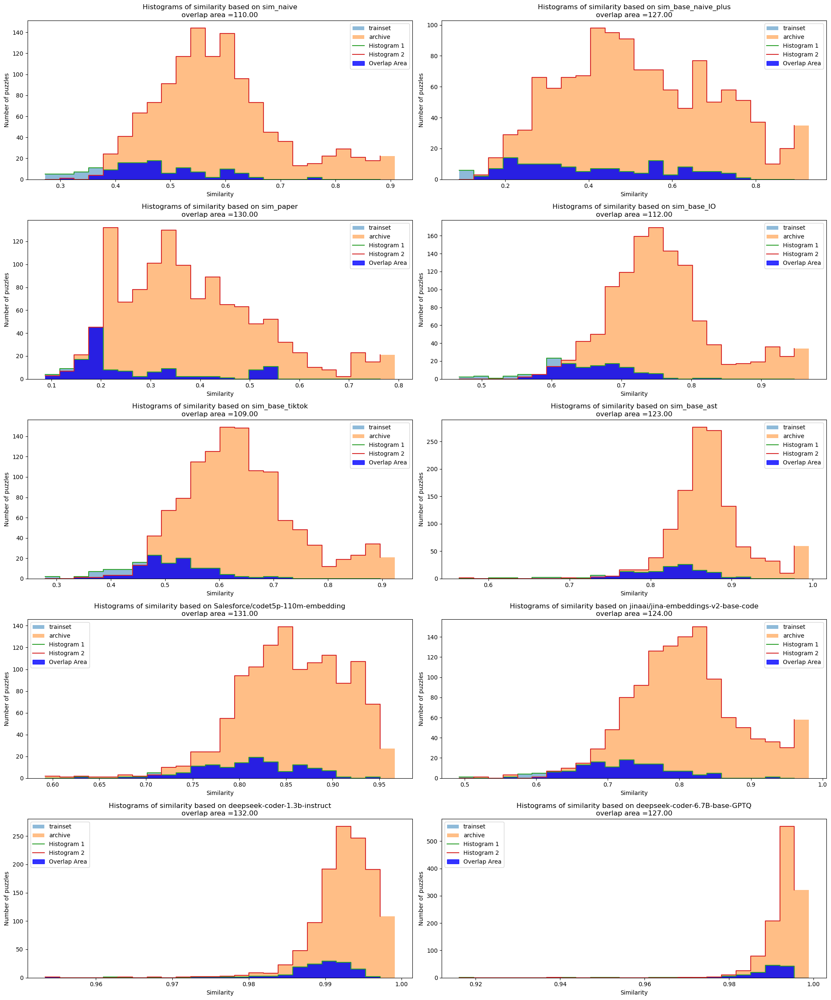

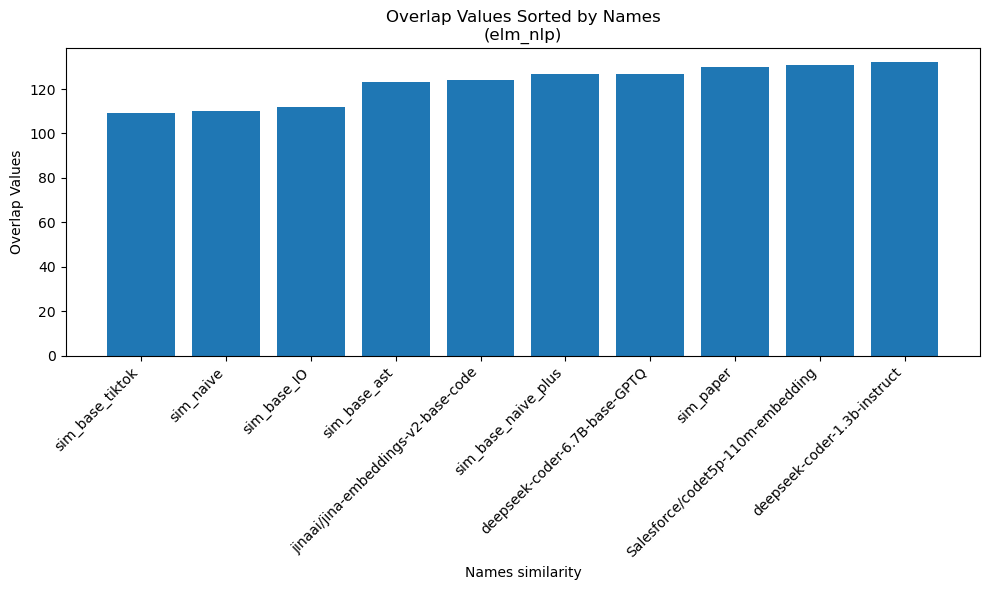

/tmp/ipykernel_4578/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


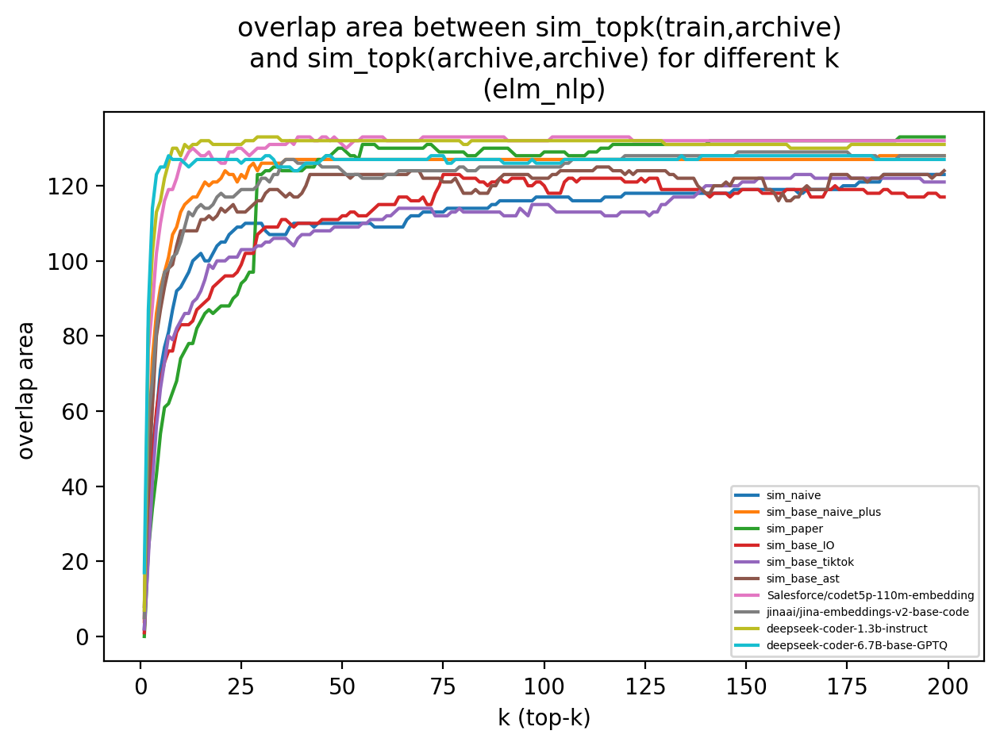

/tmp/ipykernel_4578/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


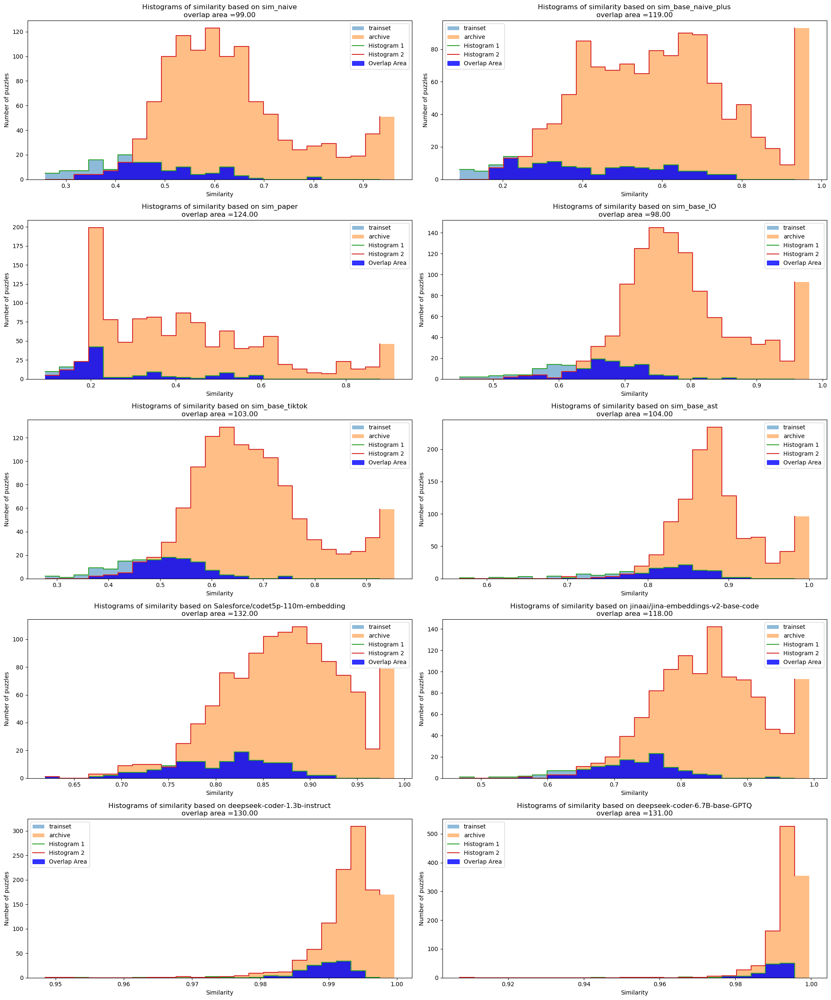

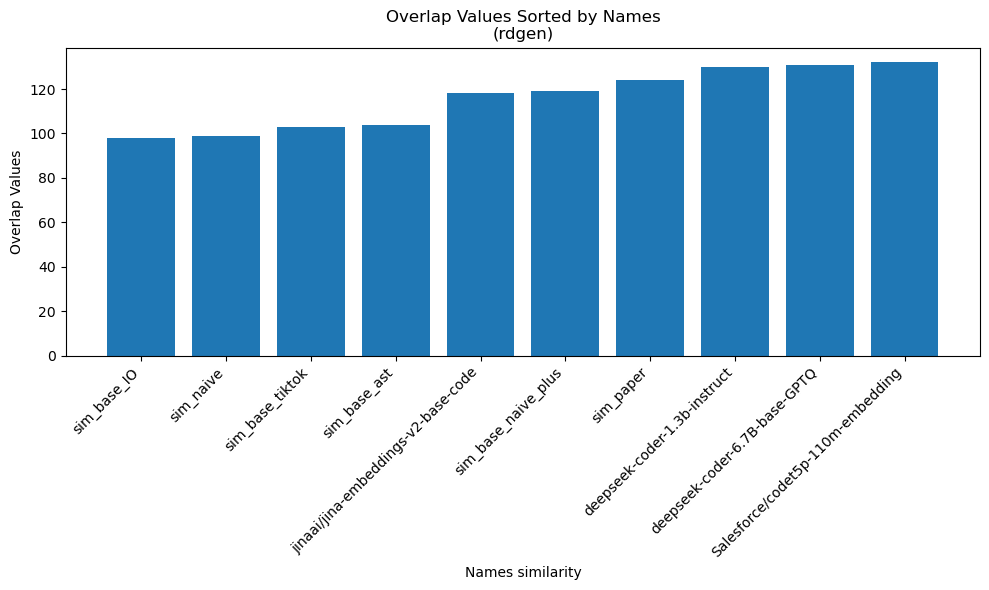

/tmp/ipykernel_4578/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


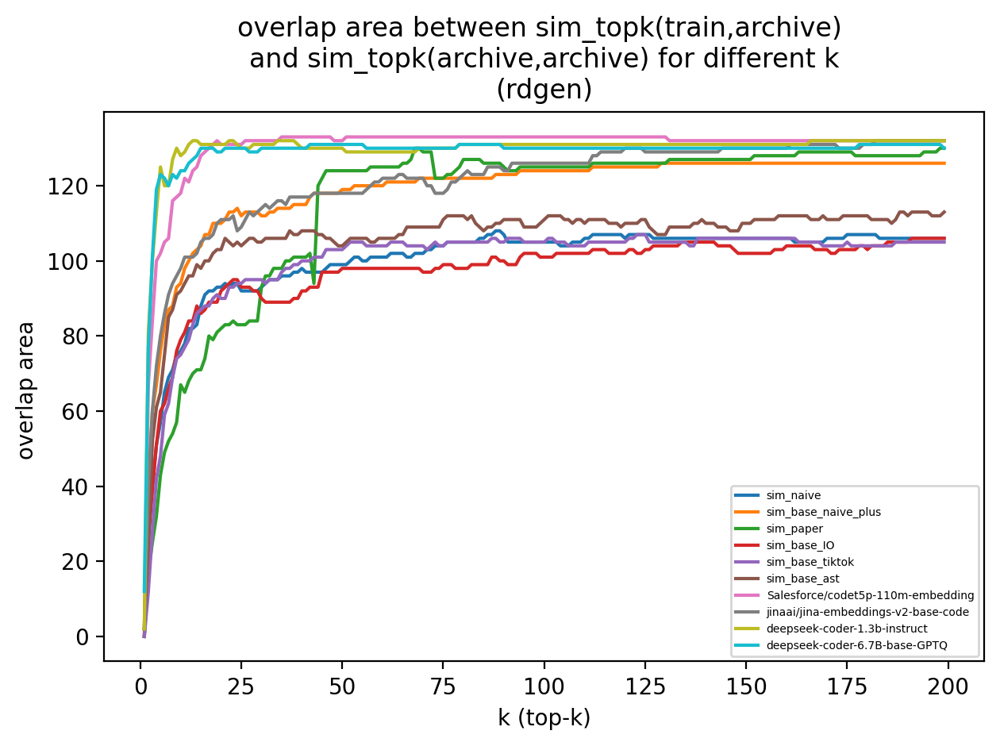

In [34]:
k=50
n_bins=25
list_sorted_overlaps=[]
for idx in range(len(list_name_path)):
    
    data = dic[list_name_path[idx]]["data"]
    list_sim= dic[list_name_path[idx]]["list_sim"]
    list_data= [d["program_str"] for d in data]
    list_data_idx= [d["idx_generation"] for d in data] 
    list_data_idx=torch.tensor(list_data_idx)
    idx_train = list_data_idx==-1
    idx_archive = list_data_idx!=-1
    sorted_overlaps = plot_all_histo(list_sim,idx_train,idx_archive,name_data=list_name_path[idx],k=k,n_bins=n_bins)
    list_sorted_overlaps.append(sorted_overlaps)
    barplot_overlap(sorted_overlaps,name_data=list_name_path[idx])

    plot_overlap_topk(list_sim,idx_train,idx_archive,list_name_sim,name_data=list_name_path[idx],max_k=200,n_bins=n_bins)

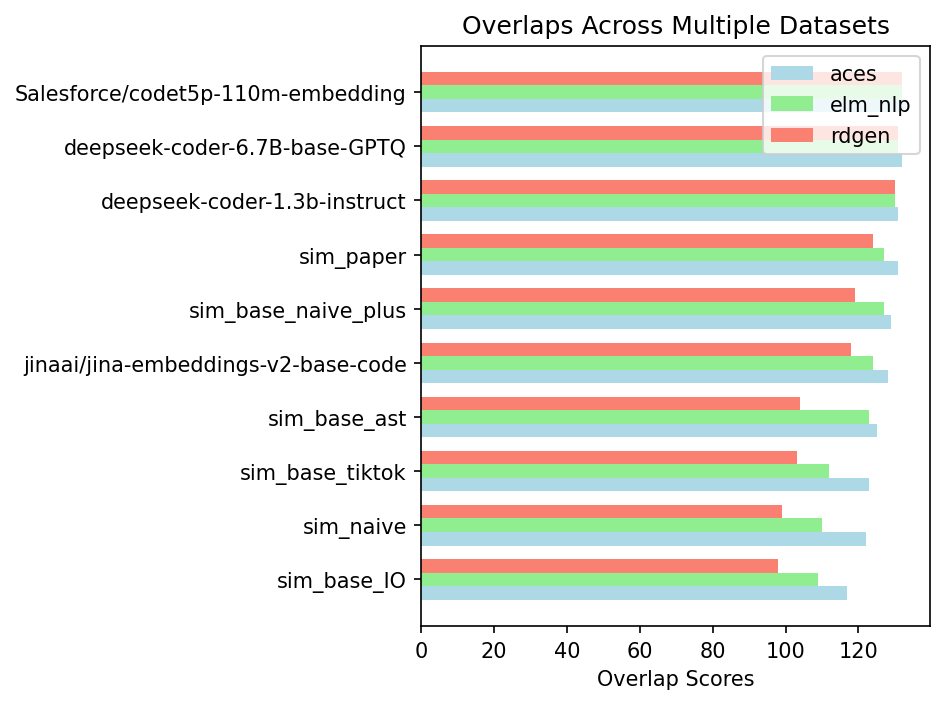

In [32]:
# Generating mock data for an arbitrary number of datasets using a for loop

n_datasets = 3  # Number of datasets to generate mock data for
colors = ['lightblue', 'lightgreen', 'salmon', 'lightgrey', 'peachpuff']  # Colors for each dataset

# Create figure and axis
fig, ax = plt.subplots(dpi=150)

width=0.25
# Plotting with a for loop
for i in range(len(list_sorted_overlaps)):
    # Generating random overlaps for this dataset
    sorted_overlaps = list_sorted_overlaps[i]
    names, overlaps = zip(*sorted_overlaps)
    ind = np.arange(len(names))

    
    # Calculating the position offset for this dataset
    position_offset = (i - n_datasets / 2) * width + width / 2
    
    # Plotting
    ax.barh(ind + position_offset, overlaps, width, label=list_name_path[i], color=colors[i % len(colors)])

ax.set(yticks=ind, yticklabels=names, xlabel='Overlap Scores', title='Overlaps Across Multiple Datasets')
ax.legend()

plt.tight_layout()
plt.savefig("/home/flowers/work/OpenELM/analysis_P3/diversity/save_plot/overlap_across_datasets.pdf")
plt.show()


/tmp/ipykernel_4578/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


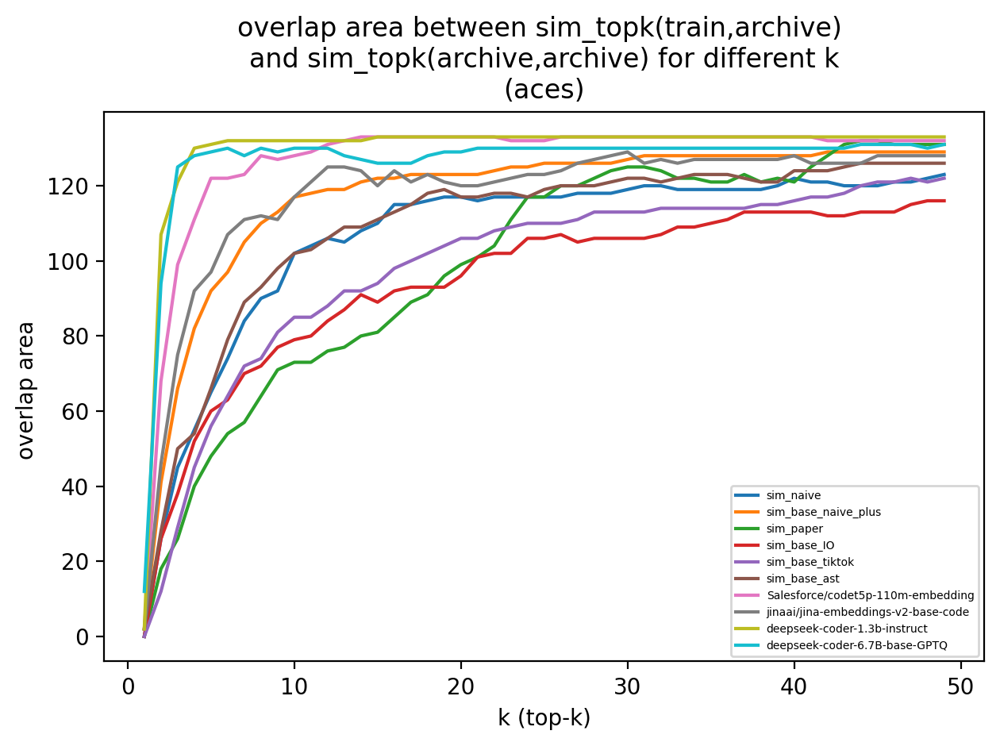

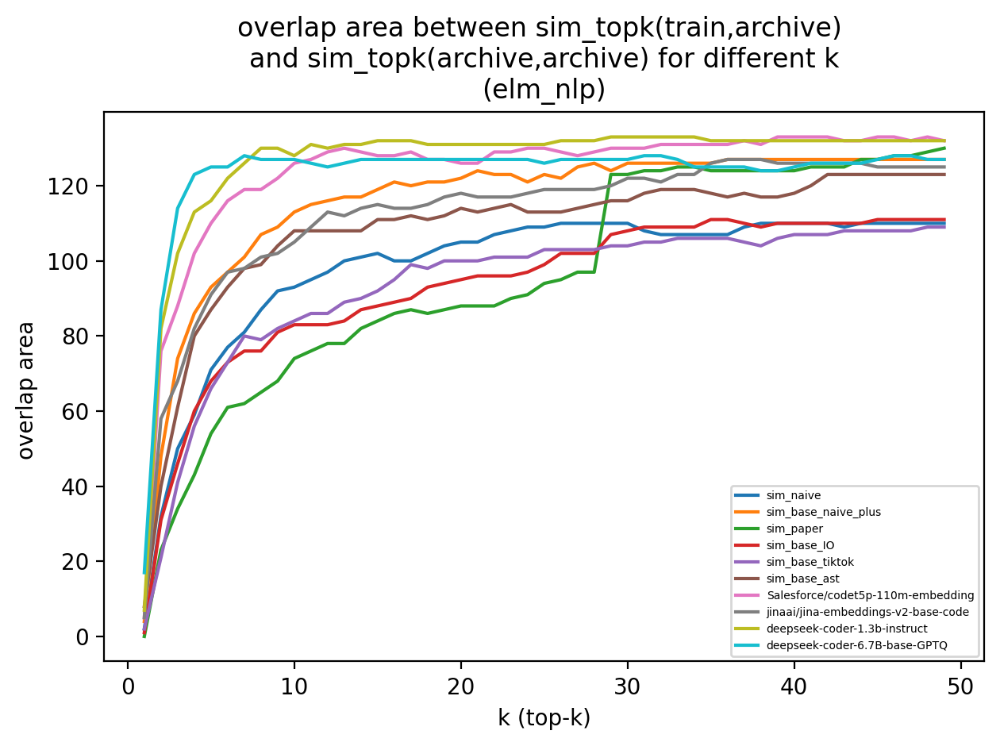

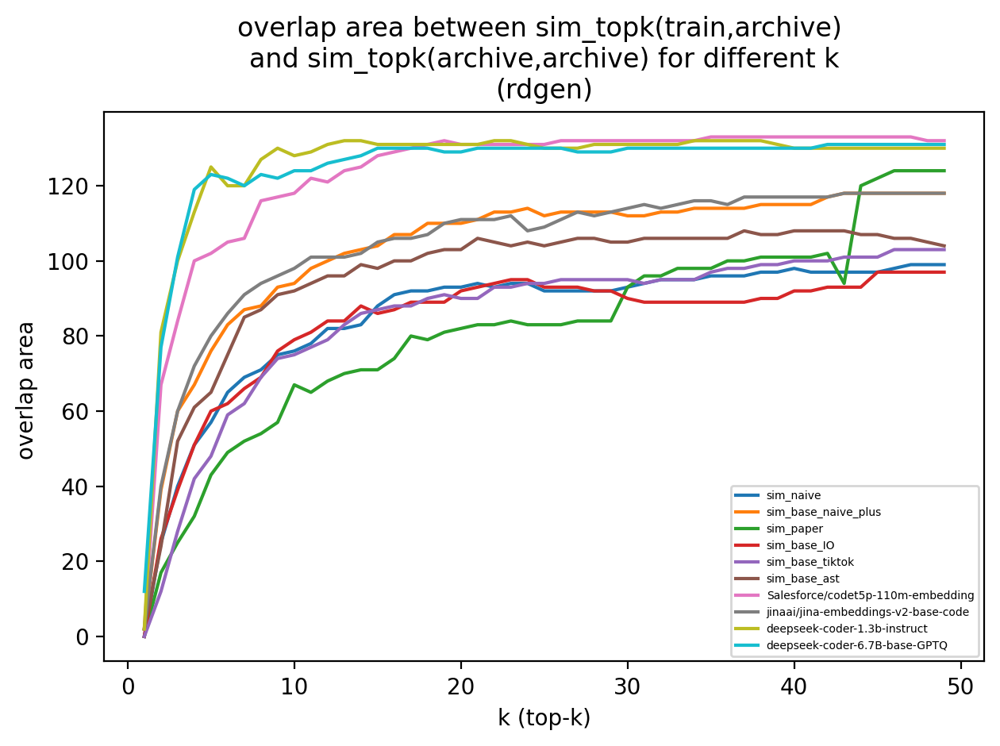

In [39]:

def plot_overlap_topk(list_sim,idx_train,idx_archive,list_name_sim,name_data,max_k=100,n_bins=100,save=True):
    k_list=[i for i in range(1,max_k)]
    list_overlap=[[] for i in range(len(list_sim))]
    for k in k_list:
        for idx,i in enumerate(list_sim):
            values_train = extract_topk(i[idx_train],k).flatten()
            values_archive = extract_topk(i[idx_archive],k).flatten()
            overlap=just_compute_histo_overlap(values_train,values_archive,nbins=n_bins)
            list_overlap[idx].append(overlap)

    plt.figure(dpi=200)
    for idx,i in enumerate(list_overlap):
        plt.plot(k_list,i)
    plt.legend(list_name_sim,fontsize="5")
    plt.xlabel("k (top-k)")
    plt.ylabel("overlap area ")
    plt.title("overlap area between sim_topk(train,archive) \nand sim_topk(archive,archive) for different k\n("+name_data+")")
    plt.tight_layout() 
    if save:
        plt.savefig("/home/flowers/work/OpenELM/analysis_P3/diversity/save_plot/overlap_topk_"+name_data+".pdf")
    plt.show()
k=50
n_bins=25
list_sorted_overlaps=[]
for idx in range(len(list_name_path)):
    
    data = dic[list_name_path[idx]]["data"]
    list_sim= dic[list_name_path[idx]]["list_sim"]
    list_data= [d["program_str"] for d in data]
    list_data_idx= [d["idx_generation"] for d in data] 
    list_data_idx=torch.tensor(list_data_idx)
    idx_train = list_data_idx==-1
    idx_archive = list_data_idx!=-1
    # sorted_overlaps = plot_all_histo(list_sim,idx_train,idx_archive,name_data=list_name_path[idx],k=k,n_bins=n_bins)
    # list_sorted_overlaps.append(sorted_overlaps)
    # barplot_overlap(sorted_overlaps,name_data=list_name_path[idx])

    plot_overlap_topk(list_sim,idx_train,idx_archive,list_name_sim,name_data=list_name_path[idx],max_k=50,n_bins=n_bins,save=False)

/tmp/ipykernel_4578/2175271116.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  sim_matr = torch.tensor(sim_matr).clone()


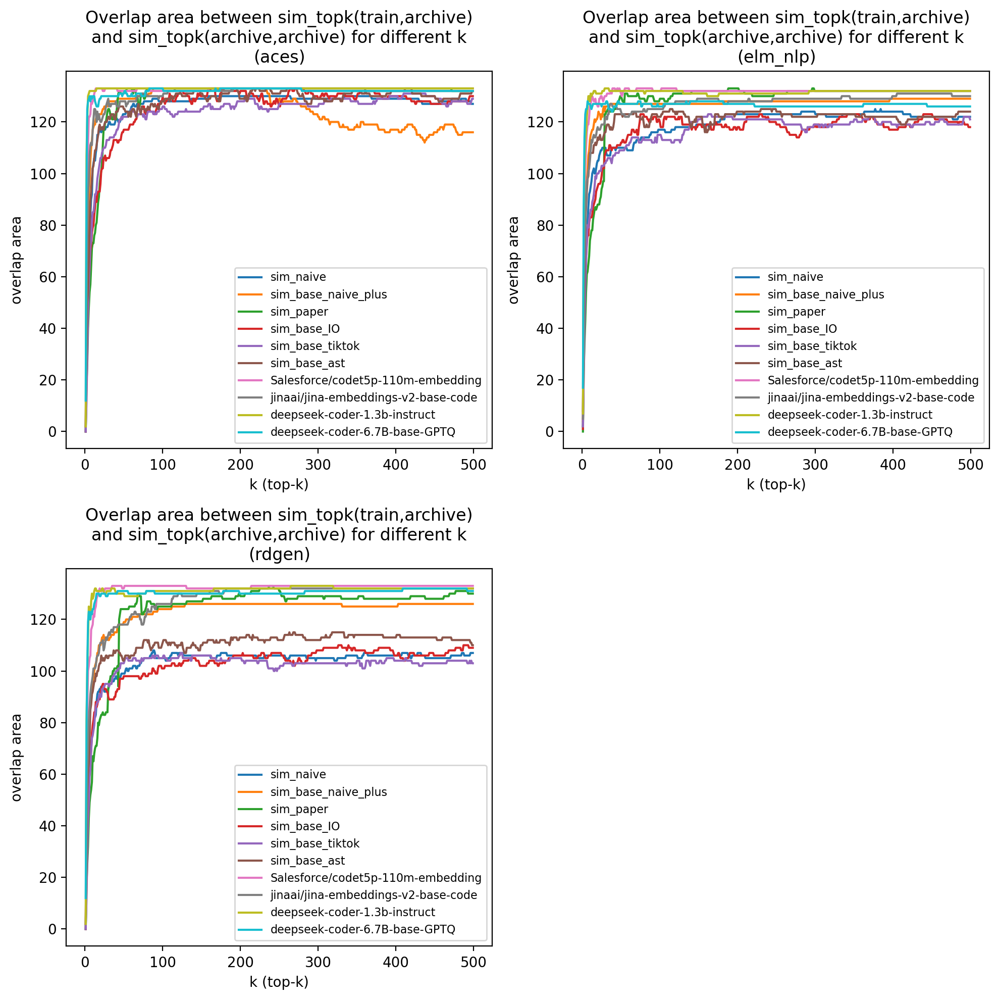

In [49]:
import matplotlib.pyplot as plt
import torch

def plot_overlap_topk(list_sim, idx_train, idx_archive, list_name_sim, name_data, ax, max_k=100, n_bins=100, save=True):
    k_list = [i for i in range(1, max_k)]
    list_overlap = [[] for _ in range(len(list_sim))]
    for k in k_list:
        for idx, sim in enumerate(list_sim):
            values_train = extract_topk(sim[idx_train], k).flatten()
            values_archive = extract_topk(sim[idx_archive], k).flatten()
            overlap = just_compute_histo_overlap(values_train, values_archive, nbins=n_bins)
            list_overlap[idx].append(overlap)

    # Use the passed axis for plotting instead of creating a new figure
    for idx, overlap in enumerate(list_overlap):
        ax.plot(k_list, overlap)
    ax.legend(list_name_sim, fontsize="8")
    ax.set_xlabel("k (top-k)")
    ax.set_ylabel("overlap area")
    ax.set_title(f"Overlap area between sim_topk(train,archive)\nand sim_topk(archive,archive) for different k\n({name_data})")

# Assuming dic, list_name_path, and other necessary functions and data structures are defined elsewhere

# Initialize subplot grid of 2x2
fig, axs = plt.subplots(2, 2, dpi=200, figsize=(10, 10))
# Flatten the axs array for easier access
axs_flat = axs.flatten()

# Main loop - adjusted to use subplots
k = 10
n_bins = 25
list_sorted_overlaps = []

for idx, name_path in enumerate(list_name_path):
    data = dic[name_path]["data"]
    list_sim = dic[name_path]["list_sim"]
    list_data = [d["program_str"] for d in data]
    list_data_idx = [d["idx_generation"] for d in data] 
    list_data_idx = torch.tensor(list_data_idx)
    idx_train = list_data_idx == -1
    idx_archive = list_data_idx != -1 
    
    # Pass the current axis to plot_overlap_topk
    plot_overlap_topk(list_sim, idx_train, idx_archive, list_name_sim, name_data=name_path, ax=axs_flat[idx], max_k=500, n_bins=n_bins)

# If the number of plots is less than the number of subplots, you can hide the unused subplots
for idx in range(len(list_name_path), len(axs_flat)):
    fig.delaxes(axs_flat[idx])

plt.tight_layout()
plt.savefig("/home/flowers/work/OpenELM/analysis_P3/diversity/save_plot/overlap_topk_all_subplot_dezoom.pdf")
plt.show()


In [ ]:
import numpy as np

# Threshold for considering programs as similar
similarity_threshold = 0.9

def find_similar_programs(similarity_matrix, programs, similarity_threshold):
    n = len(programs)
    similar_pairs = []

    for i in range(n):
        for j in range(i+1, n):  # To avoid repeating pairs and comparing the same program
            if similarity_matrix[i][j] >= similarity_threshold:
                similar_pairs.append((programs[i], programs[j],(i,j),similarity_matrix[i][j]))
    
    return similar_pairs

# Get the similar programs
similar_programs = find_similar_programs(similarity_matrix, list_data, similarity_threshold)

# Print the similar programs
for pair in similar_programs:
    print( "===============\n")
    print(f'similarity = {pair[3]}, idx pair = {pair[2]}\n\n{pair[0]}\n \nis similar to:\n\n{pair[1]}')



In [ ]:
import numpy as np

# Threshold for considering programs as similar
similarity_threshold = 0.9

def find_similar_programs(similarity_matrix, programs, similarity_threshold):
    n = len(programs)
    similar_pairs = []

    for i in range(n):
        all_similar_puzzle=[]
        flag=False
        for j in range(i+1, n):  # To avoid repeating pairs and comparing the same program
            if similarity_matrix[i][j] >= similarity_threshold:
                    flag=True
                    all_similar_puzzle.append((programs[j],similarity_matrix[i][j]))
        if flag:
            similar_pairs.append((programs[i], all_similar_puzzle))
    
    return similar_pairs

# Get the similar programs
similar_programs = find_similar_programs(list_sim[0], list_data, similarity_threshold)

# Print the similar programs
for pair in similar_programs:
    print( "===============\n ")
    print("problem reference:\n",pair[0])
    
    for p in pair[1]:
        print("\n-------------------\n")
        print("similar problems with similarity =",p[1],"\n")
        print(p[0])



In [ ]:
data[137]["puzzle_history"]

# compare f and g

In [16]:
import ast

example_code = """list_sim
def g(n=5) -> int:
    return math.factorial(n)

assert f(g()) == True
"""
def extract_f_g(source_code):
    function_names=["f","g"]
    # Parse the example code to an AST
    parsed_code = ast.parse(source_code)

    # Function to extract function definitions based on their names
    f=""
    g=""
    for child in ast.iter_child_nodes(parsed_code):
        if isinstance(child, ast.FunctionDef) and child.name in function_names:
            if child.name=="f":
                f=ast.get_source_segment(source_code, child)
            elif child.name=="g":
                g=ast.get_source_segment(source_code, child)
    return f,g


def extract_f_g_body(source_code):
    function_names = ["f", "g"]
    # Parse the example code to an AST
    parsed_code = ast.parse(source_code)
    
    # Initialize empty strings to hold the body of each function
    f_body = ""
    g_body = ""
    
    # Traverse the AST to find the specified function definitions
    for node in ast.walk(parsed_code):
        if isinstance(node, ast.FunctionDef) and node.name in function_names:
            # Extract the body of the function
            body_source = [ast.get_source_segment(source_code, stmt) for stmt in node.body]
            body_source_str = '\n'.join(body_source)
            # Assign the extracted body to the corresponding variable
            if node.name == "f":
                f_body = body_source_str
            elif node.name == "g":
                g_body = body_source_str
                
    return f_body, g_body

In [17]:
def matrice_sim_fg(list_code,sim,body=True):
    # Parse function f and function g with ASTs
    list_sim=[]
    for code in list_code:
        if body:
            f,g = extract_f_g_body(code)
        else:
            # try:
            f,g = extract_f_g(code)
            # except Exception as e:
            #     f,g = "",""
            #     print("error parsing",e)
        try:
            list_sim.append(sim(f,g))
        except:
            list_sim.append(0)
    return list_sim

    
    

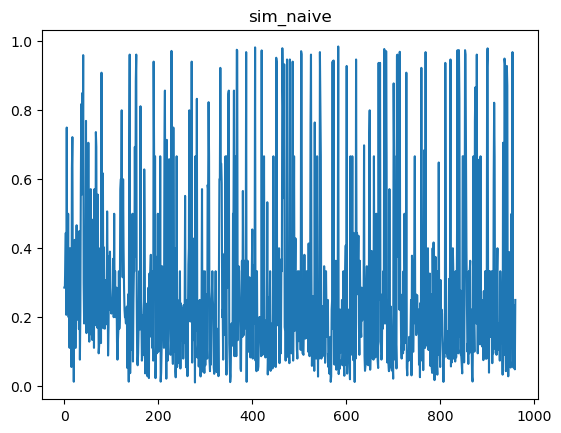

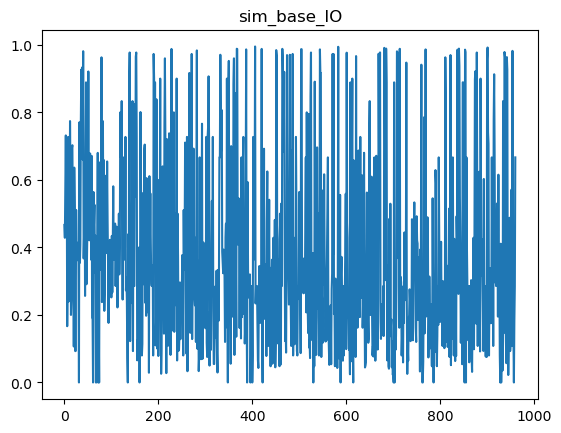

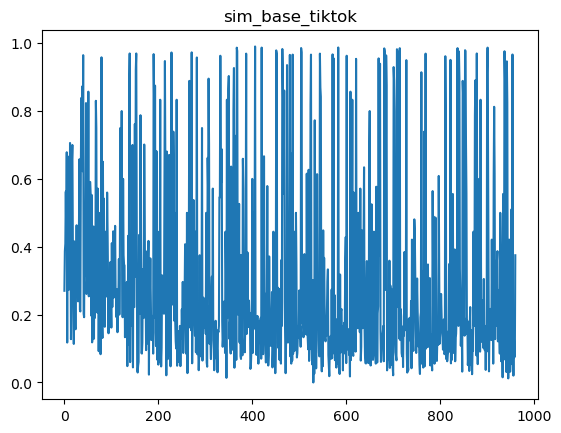

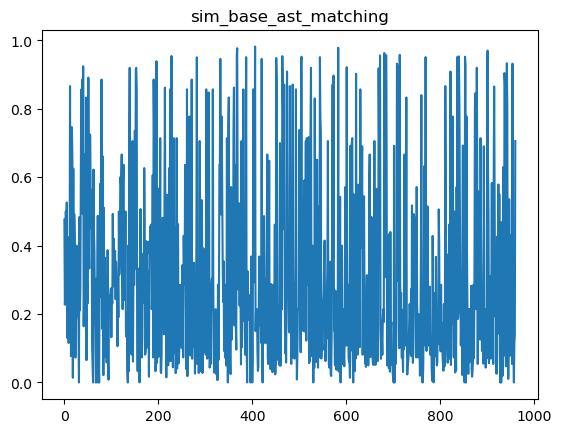

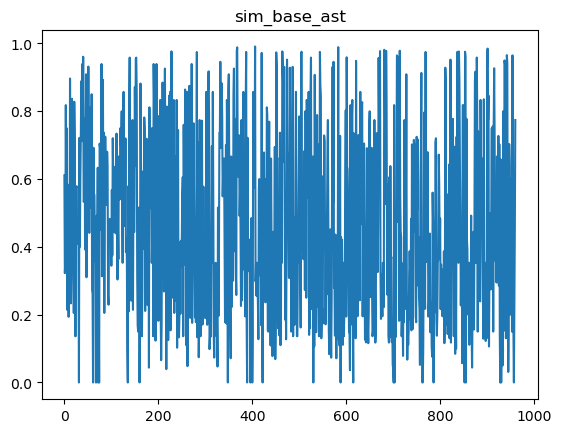

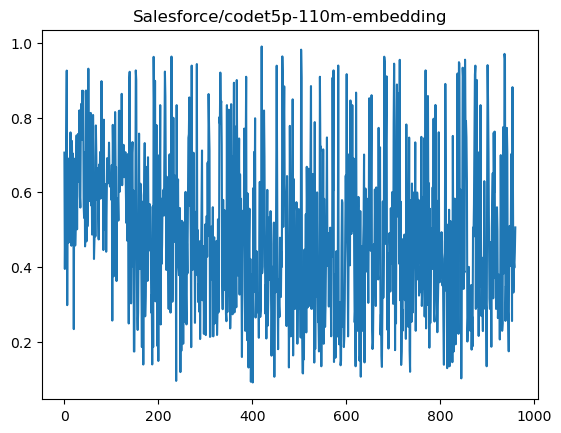

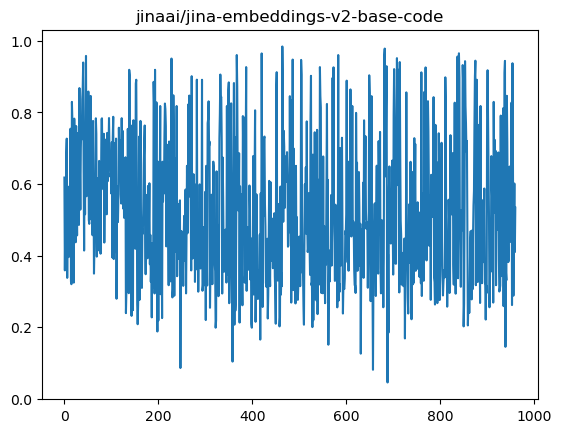

In [20]:

list_sim_fg= []
list_sim_function=[sim_naive,sim_base_IO,sim_base_tiktok,sim_base_ast_matching,sim_base_ast,sim_pairwise_llm,sim_pairwise_llm2]

for i,sim in enumerate(list_sim_function):
    similarity_matrix = matrice_sim_fg(list_data,sim=sim)
    list_sim_fg.append(similarity_matrix)
    plt.figure(dpi=100)
    plt.title(list_name[i])
    plt.plot(similarity_matrix)
    plt.show()



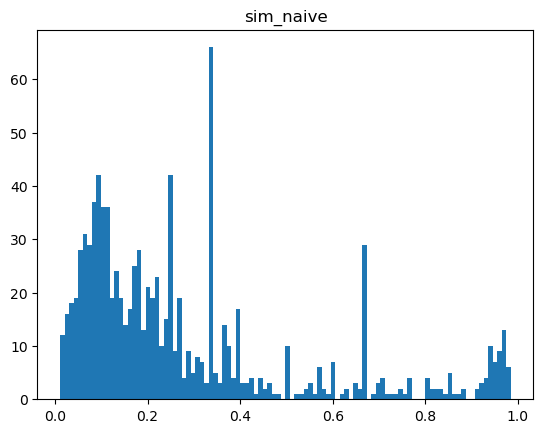

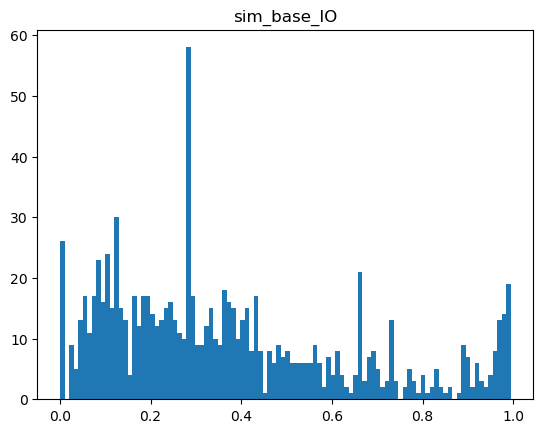

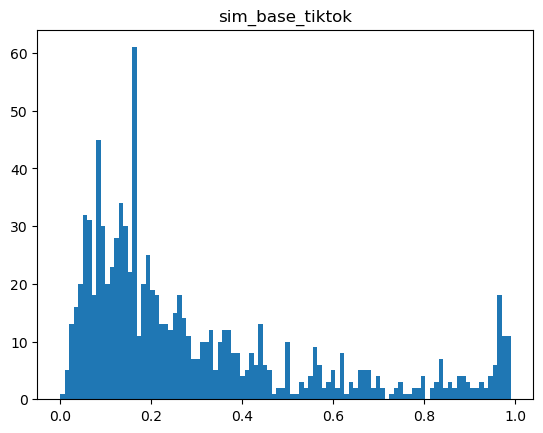

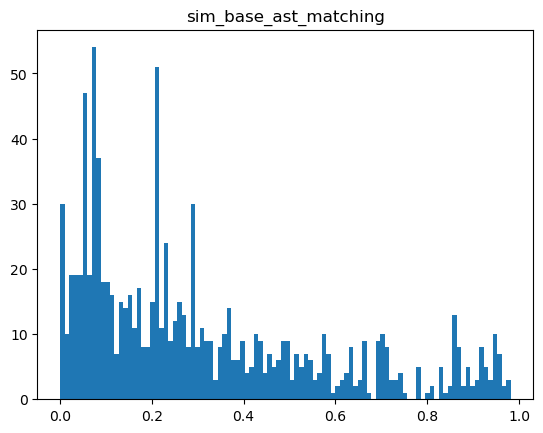

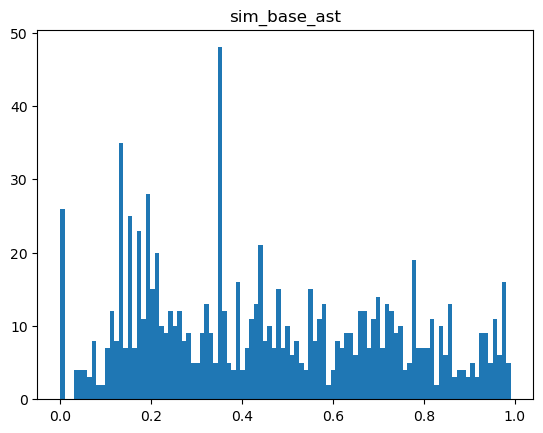

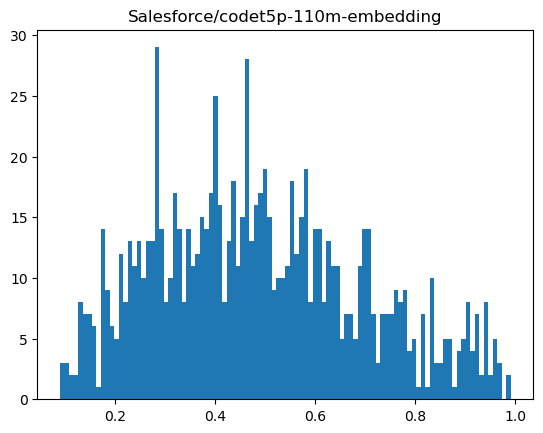

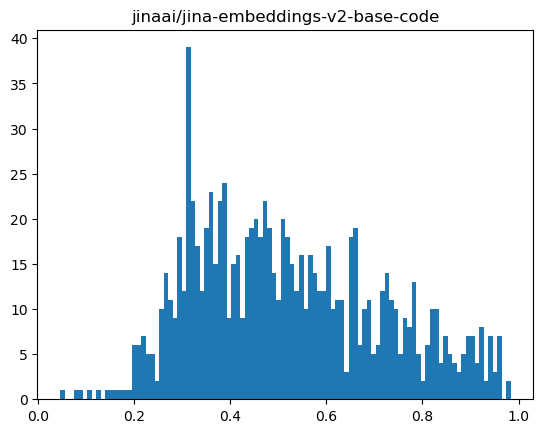

In [21]:
for idx,sim in enumerate(list_sim_fg):

    plt.hist(sim,bins=100)
    plt.title(list_name[idx])
    plt.show()